In [5]:
import numpy as np
import pandas as pd
import cv2
import matplotlib.pyplot as plt
import os
from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dropout, Flatten, Dense
import random

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
import sys
sys.path.append('/content/drive/MyDrive/Computer Vision/brain/classification/Functions')


In [4]:
from image_preprocessing_brain import image_preprocessing
from load_images_brain import load_images

# Image Preprocessing
* Preprocessing is a very important and main step in image processing, as scanned images are usually displayed in gray scale or color and also they <b>suffer from noise</b>

* <b>Noise removal and edge detection</b> are the two most important steps in processing any digital images to improve the
information in the picture so that it can be easily understood and to make it suitable and readable for any machine working on those images.

* That's why, some preprocessing steps are performed on the image.



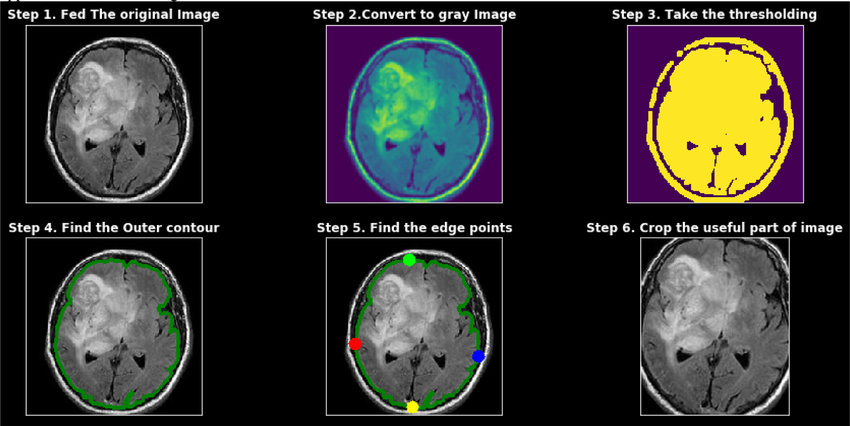

# Load the preproccessed brain images

In [6]:
# Define the path to your data folders
data_path = '/content/drive/MyDrive/Computer Vision/Dataset/Brain scans'

# Load images and labels
images, labels = load_images(data_path)

# shuffle images and labels
combined = list(zip(images, labels))
random.shuffle(combined)
images, labels = zip(*combined)

## Preprocessing Sample

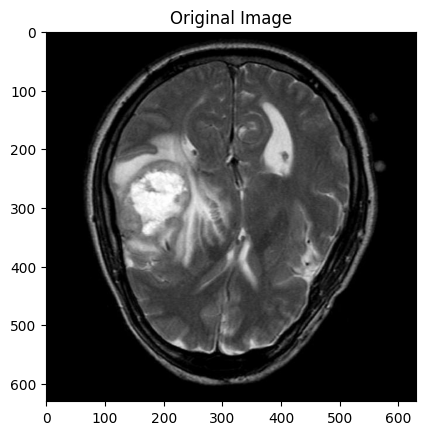

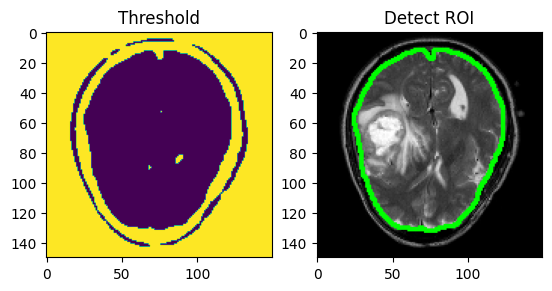

Text(0.5, 1.0, 'Cropped Image')

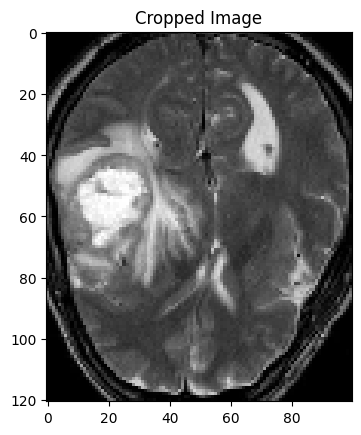

In [ ]:
new_img = image_preprocessing('/content/drive/MyDrive/Computer Vision/Dataset/Brain scans/Tumor/TRAIN/y100.jpg')
plt.imshow(new_img)
plt.title('Cropped Image')

# Build a model to classify whether Tumor or No-tumor

## Train Test Split

In [7]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(images, labels, test_size=0.2, random_state=42)

# Convert the images to numpy arrays and normalize the pixel values
X_train = np.array(X_train).astype(np.float32) / 255
X_test = np.array(X_test).astype(np.float32) / 255
y_train = np.array(y_train)
y_test = np.array(y_test)

print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

(960, 150, 150, 3)
(241, 150, 150, 3)
(960,)
(241,)


In [12]:
# Define the model
model = Sequential()
model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(150, 150, 3)))
model.add(MaxPooling2D((2, 2)))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D((2, 2)))
model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D((2, 2)))
model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D((2, 2)))
model.add(Flatten())
model.add(Dense(512, activation='relu'))
model.add(Dense(1, activation='sigmoid'))


In [13]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 148, 148, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 74, 74, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 72, 72, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 36, 36, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 34, 34, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 17, 17, 128)      0

In [14]:
# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['binary_accuracy'])

In [15]:
# Train the model
history = model.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_test, y_test))

Epoch 1/10
30/30 [==============================] - 63s 2s/step - loss: 0.7045 - binary_accuracy: 0.5417 - val_loss: 0.5851 - val_binary_accuracy: 0.6598
Epoch 2/10
30/30 [==============================] - 61s 2s/step - loss: 0.4721 - binary_accuracy: 0.7906 - val_loss: 0.4072 - val_binary_accuracy: 0.8216
Epoch 3/10
30/30 [==============================] - 59s 2s/step - loss: 0.3303 - binary_accuracy: 0.8698 - val_loss: 0.3689 - val_binary_accuracy: 0.8382
Epoch 4/10
30/30 [==============================] - 69s 2s/step - loss: 0.2624 - binary_accuracy: 0.9000 - val_loss: 0.3234 - val_binary_accuracy: 0.8672
Epoch 5/10
30/30 [==============================] - 61s 2s/step - loss: 0.2206 - binary_accuracy: 0.9094 - val_loss: 0.3337 - val_binary_accuracy: 0.8797
Epoch 6/10
30/30 [==============================] - 61s 2s/step - loss: 0.1609 - binary_accuracy: 0.9406 - val_loss: 0.3139 - val_binary_accuracy: 0.8880
Epoch 7/10
30/30 [==============================] - 61s 2s/step - loss: 0.12

## Save the Model

In [32]:
model.save('brainClassifier.h5')

## Plot the results

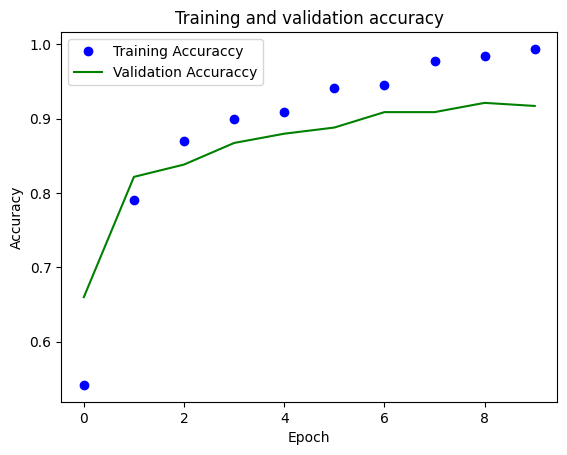

In [16]:
acc = history.history['binary_accuracy']
val_acc = history.history['val_binary_accuracy']
epochs = range(len(acc))

plt.plot(epochs, acc, 'bo', label='Training Accuraccy')
plt.plot(epochs, val_acc, 'g', label='Validation Accuraccy')
plt.title('Training and validation accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

## Model Evaluation

In [17]:
# Evaluate the model
loss, accuracy = model.evaluate(X_test, y_test, verbose=0)
print('Test loss:', loss)
print('Test accuracy:', accuracy)

Test loss: 0.3093957006931305
Test accuracy: 0.9170124530792236


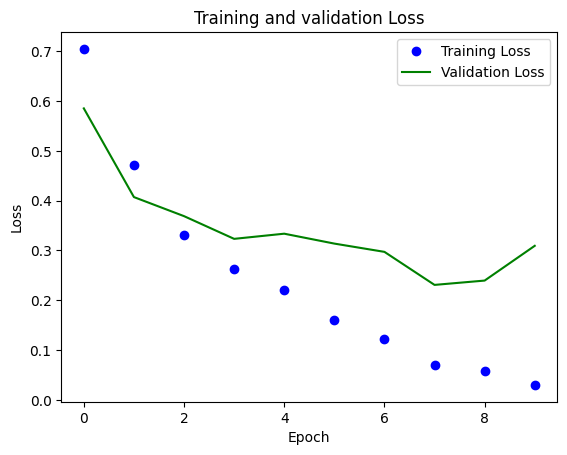

In [18]:
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(len(acc))

plt.plot(epochs, loss, 'bo', label='Training Loss')
plt.plot(epochs, val_loss, 'g', label='Validation Loss')
plt.title('Training and validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

## Evaluate using different metrices

In [19]:
from sklearn.metrics import confusion_matrix, classification_report

In [20]:
# using confusion metrix
y_pred = model.predict(X_test)

# Convert predictions from probabilities to binary labels
y_pred = (y_pred > 0.5)

# Calculate the confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the classification report
cr = classification_report(y_test, y_pred)

# Print the classification report
print(cr)


8/8 [==============================] - 6s 738ms/step
              precision    recall  f1-score   support

           0       0.90      0.91      0.90       104
           1       0.93      0.92      0.93       137

    accuracy                           0.92       241
   macro avg       0.91      0.92      0.92       241
weighted avg       0.92      0.92      0.92       241



## Plot the Confusion Matrix

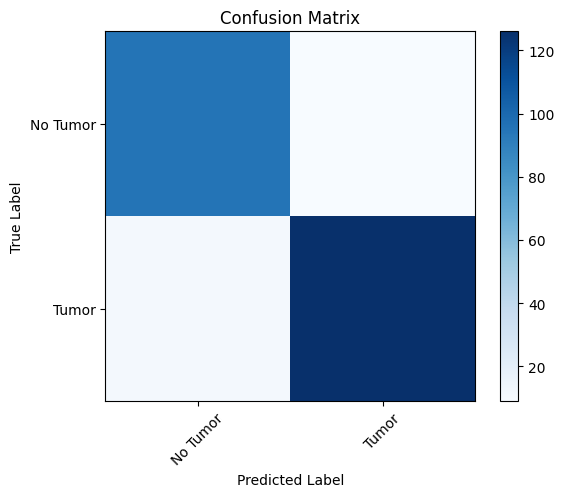

In [21]:
# Plot the confusion matrix
plt.imshow(cm, cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()
tick_marks = np.arange(2)
plt.xticks(tick_marks, ['No Tumor', 'Tumor'], rotation=45)
plt.yticks(tick_marks, ['No Tumor', 'Tumor'])
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

In [22]:
predictions = model.predict(X_test)

8/8 [==============================] - 6s 699ms/step


In [31]:
# convert the predictions into binary [0 : 'no tumor', 1 : 'Tumor']
np.round(predictions)

array([[0.],
       [1.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [1.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [0.],
       [0.],
       [1.],
       [1.],
       [0.],
       [1.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [1.],
       [1.],
       [1.],
       [0.],
       [1.],
       [0.],
       [1.],
       [0.],
       [0.],
       [0.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [1.],
       [0.],
       [1.],
       [1.],
       [0.],
       [1.],
       [0.],
       [0.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [0.],
       [1.],
       [1.],
       [1.],
       [0.],
       [1.],
       [1.],
       [0.],

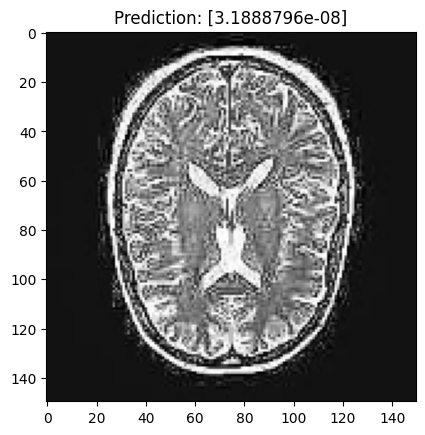

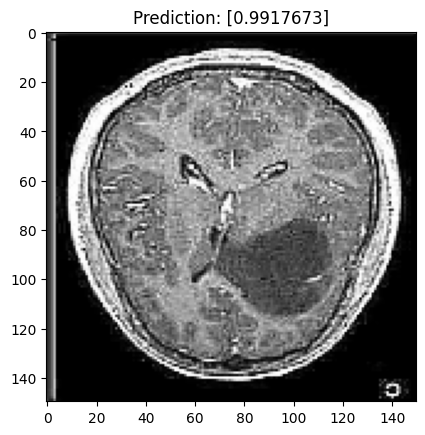

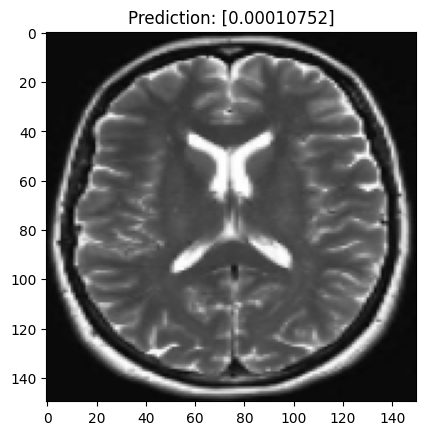

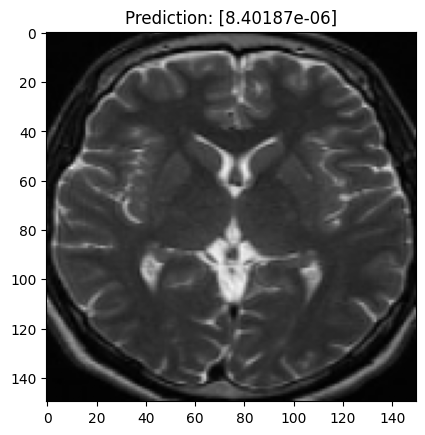

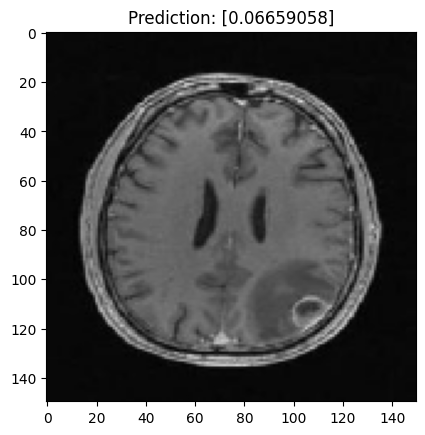

...

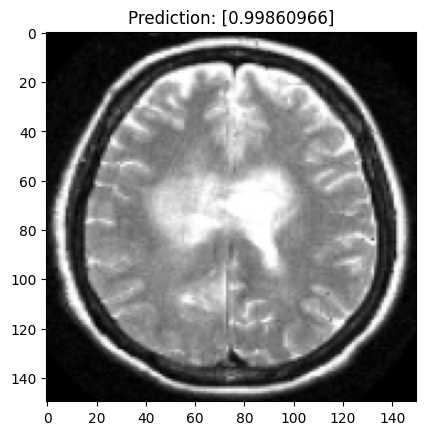

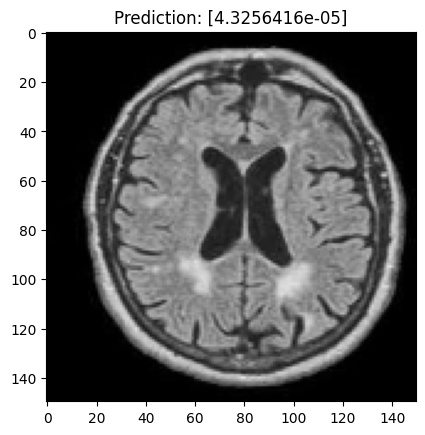

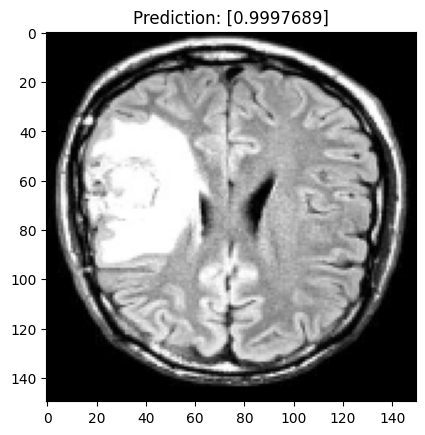

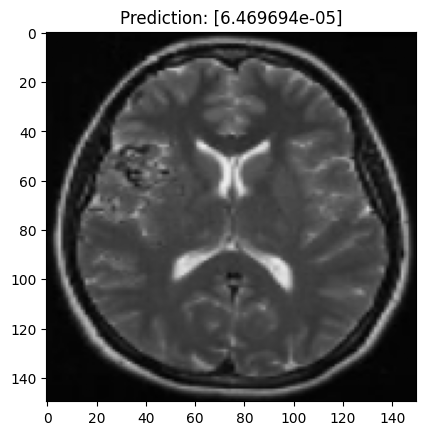

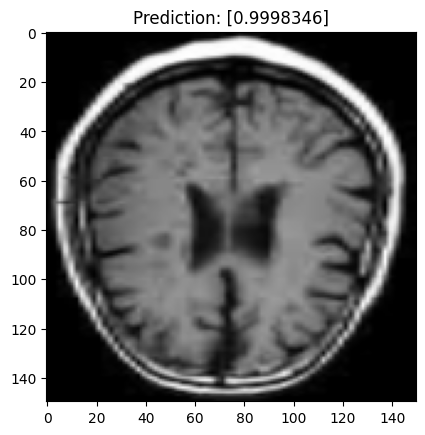

In [28]:
for i in range(len(X_test)):
    image = X_test[i]
    prediction = predictions[i]
    
    # Print the image path and the corresponding prediction
    plt.imshow(X_test[i])
    plt.title(f"Prediction: {prediction}")
    plt.show()